In [1]:
# Necessary imports
import nltk, re, pandas as pd, xml, os, sklearn, string, numpy as np, time, pickle, gc as gc, warnings
import seaborn as sns, matplotlib.pyplot as plt, plotly.express as px, plotly.offline as plotly_offline
from nltk.corpus import stopwords
from bs4 import BeautifulSoup
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from sklearn.model_selection import train_test_split, cross_validate, StratifiedShuffleSplit, cross_val_score
from sklearn.naive_bayes import GaussianNB, MultinomialNB, ComplementNB, BernoulliNB
from nltk.stem.snowball import SnowballStemmer

from research_utils import *

# Other settings
gc.enable()
warnings.filterwarnings("ignore")
plotly_offline.init_notebook_mode(connected = True)

In [2]:
global sims
global folds

sims = 10
folds = 3

## Step 1 - Load and clean

In [3]:
dfs, names, classes = load_imdb_data()

In [4]:
# Show class distribution
print(classes.value_counts())

-1    25000
 1    25000
Name: classification, dtype: int64


## Step 2 - Perform routine analysis
- Correlation heatmap with specificities
- Distribution of words
- Class evaluation

### Correlation Heatmaps

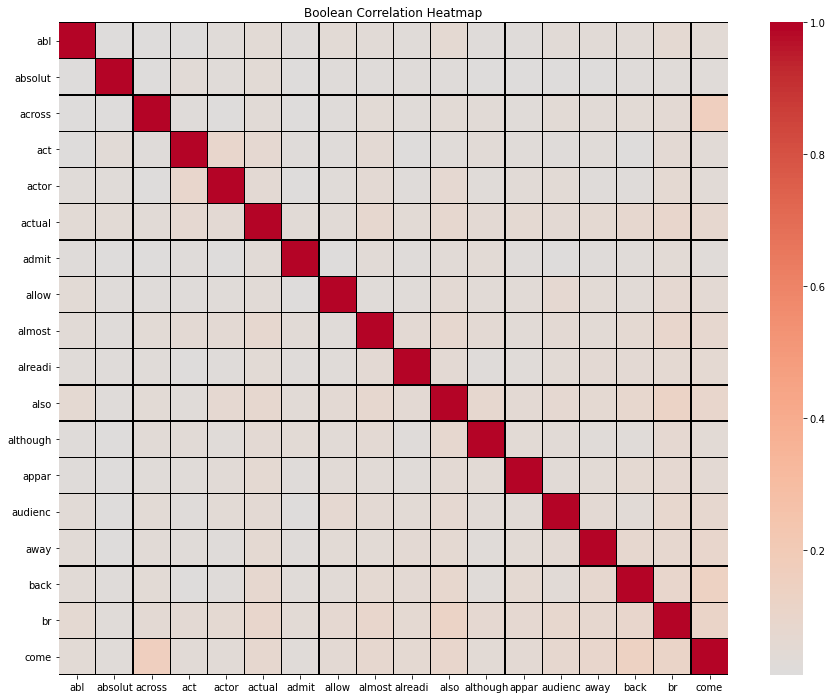

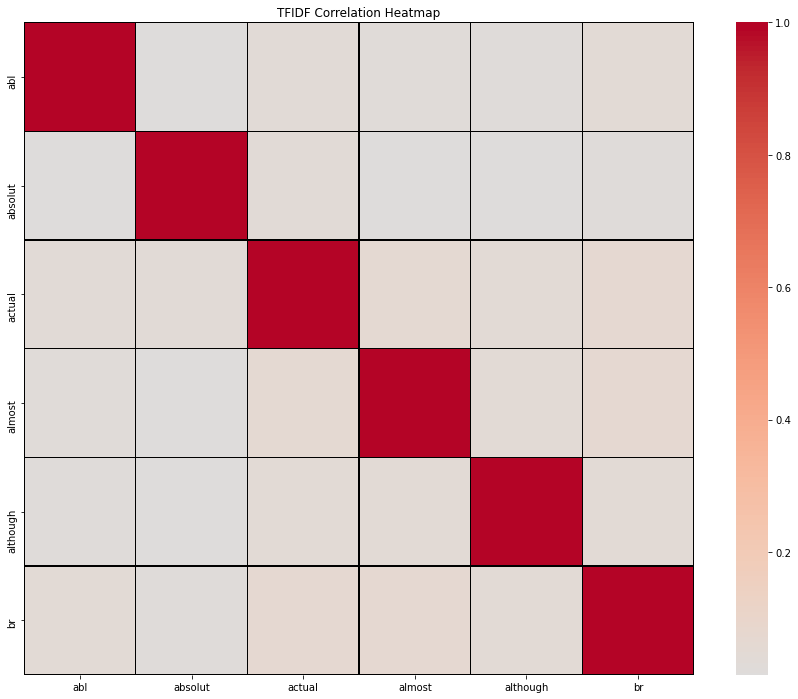

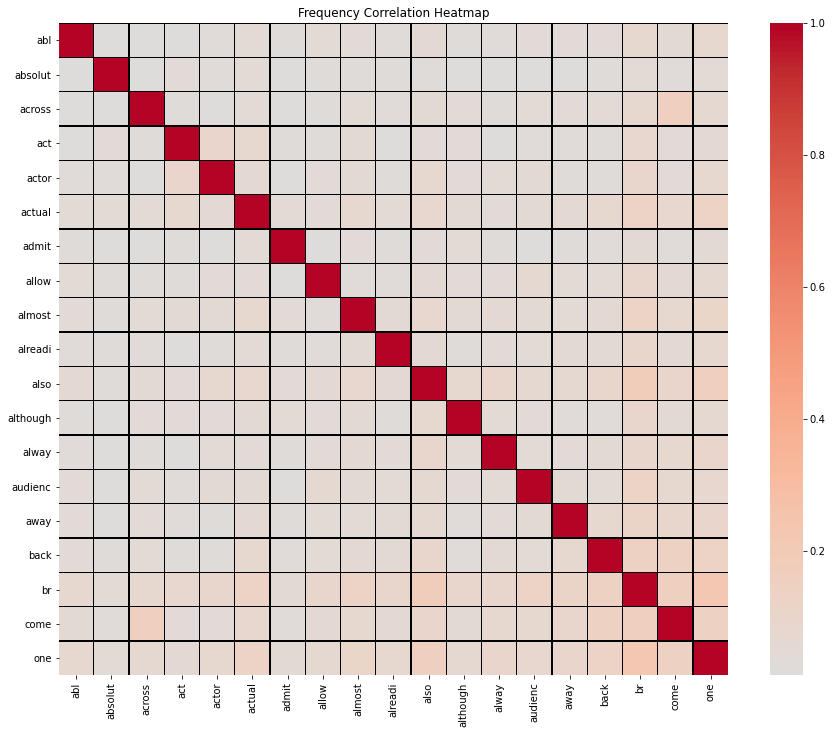

In [5]:
# Start calculating their correlation

for i in range(len(dfs)):
    plot_correlations(dfs[i], names[i])

### Distribution Plots

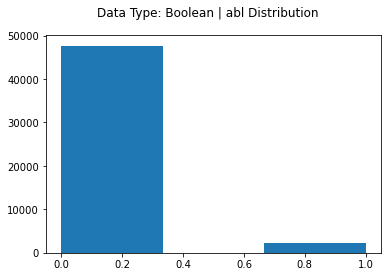

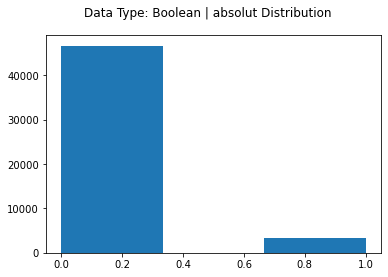

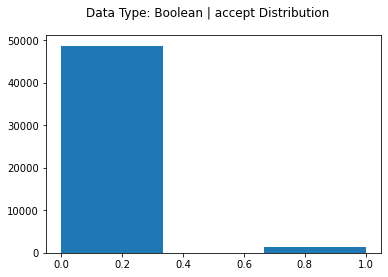

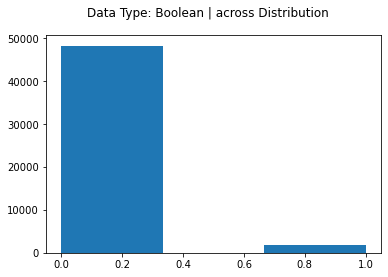

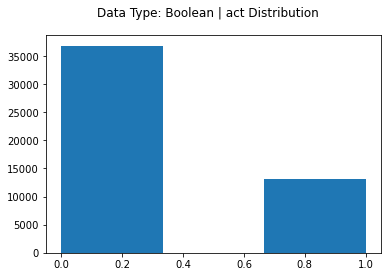

...

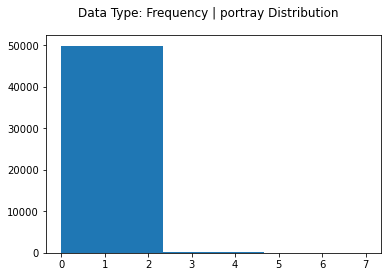

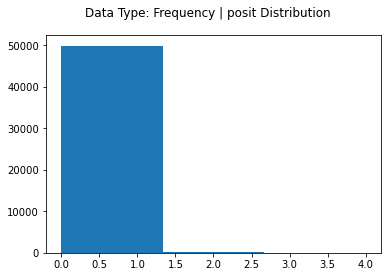

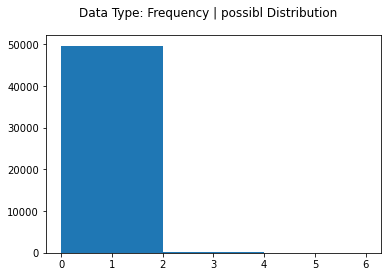

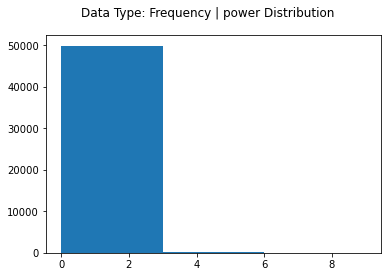

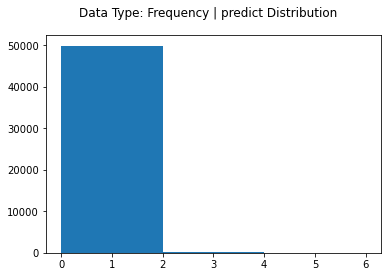

In [6]:
# Get some quick plots to show the distributions of each word in each dataset
for i in range(len(dfs)):
    plot_df_distributions(dfs[i], names[i])

### Class Evaluation

In [7]:
# Confirm class distribution
classes.value_counts()

-1    25000
 1    25000
Name: classification, dtype: int64

### Step 3 - Perform classification on binary data

In [8]:
# Test some basic classifiers

# Declare a list of classifiers to try
# classifiers = [GaussianNB(), MultinomialNB(), BernoulliNB(), 
#                SVC(C=1.0, kernel='linear', degree=3, gamma='auto')]

classifiers = [GaussianNB(), MultinomialNB(), BernoulliNB()]

# Create blank dataframes to hold the results of the classification attempts
boolean_results = pd.DataFrame(columns = ['Simulation', 'Classifier', 'Best', 'Worst', 'Average'])
tfidf_results = pd.DataFrame(columns = ['Simulation', 'Classifier', 'Best', 'Worst', 'Average'])
freq_results = pd.DataFrame(columns = ['Simulation', 'Classifier', 'Best', 'Worst', 'Average'])

# Run a given number of simulations
for n in range(sims):
    # Loop through each of the datasets
    for i in range(len(dfs)):
        print("*--------------------------------------------*")
        # Copy the dataset
        temp = dfs[i].copy()

        # Try each classifier
        for clf in classifiers:
            # Take the classifiers name
            name = str(clf.__class__.__name__)
            try:  
                # Utilize a shuffle split for the cross validation
                cv = StratifiedShuffleSplit(n_splits = folds, test_size = 0.33, random_state=np.random.randint(1,100))
                # Capture the best, worst, and average across the splits
                best = round(max(cross_val_score(clf, temp, classes, cv=cv)), 5)
                worst = round(min(cross_val_score(clf, temp, classes, cv=cv)), 5)
                avg = round((sum(cross_val_score(clf, temp, classes, cv=cv)) / len(cross_val_score(clf, temp, classes, cv=cv))), 5)
                # Print out results
                print("Simulation: {} | Data: {} | Classifier: {} | Best: {} | Worst: {} | Average: {}".format(n+1, names[i], name, best, worst, avg))
            except:
                # Alert if any error
                print("Error Calculating: {}".format(name))

            # Create a row to append to the respective df with the results
            temp_row = [n+1, name, best, worst, avg]
            
            # Append to correct df
            if(names[i] == 'Boolean'):
                boolean_results.loc[len(boolean_results), :] = temp_row
            elif(names[i] == 'TFIDF'):
                tfidf_results.loc[len(tfidf_results), :] = temp_row
            else:
                freq_results.loc[len(freq_results), :] = temp_row
        
        # Delete temp df
        del(temp)
        
        # Free up memory
        gc.collect()

*--------------------------------------------*
Simulation: 1 | Data: Boolean | Classifier: GaussianNB | Best: 0.81703 | Worst: 0.81176 | Average: 0.81356
Simulation: 1 | Data: Boolean | Classifier: MultinomialNB | Best: 0.83012 | Worst: 0.82588 | Average: 0.82855
Simulation: 1 | Data: Boolean | Classifier: BernoulliNB | Best: 0.82503 | Worst: 0.82303 | Average: 0.82408
*--------------------------------------------*
Simulation: 1 | Data: TFIDF | Classifier: GaussianNB | Best: 0.8143 | Worst: 0.80842 | Average: 0.81089
Simulation: 1 | Data: TFIDF | Classifier: MultinomialNB | Best: 0.83212 | Worst: 0.83152 | Average: 0.83174
Simulation: 1 | Data: TFIDF | Classifier: BernoulliNB | Best: 0.82776 | Worst: 0.82418 | Average: 0.82558
*--------------------------------------------*
Simulation: 1 | Data: Frequency | Classifier: GaussianNB | Best: 0.79927 | Worst: 0.79061 | Average: 0.79537
Simulation: 1 | Data: Frequency | Classifier: MultinomialNB | Best: 0.82642 | Worst: 0.82164 | Average: 0.8

Simulation: 8 | Data: TFIDF | Classifier: GaussianNB | Best: 0.81206 | Worst: 0.80952 | Average: 0.81103
Simulation: 8 | Data: TFIDF | Classifier: MultinomialNB | Best: 0.83164 | Worst: 0.83012 | Average: 0.83105
Simulation: 8 | Data: TFIDF | Classifier: BernoulliNB | Best: 0.82685 | Worst: 0.82303 | Average: 0.82558
*--------------------------------------------*
Simulation: 8 | Data: Frequency | Classifier: GaussianNB | Best: 0.80067 | Worst: 0.79327 | Average: 0.79675
Simulation: 8 | Data: Frequency | Classifier: MultinomialNB | Best: 0.82661 | Worst: 0.82182 | Average: 0.82416
Simulation: 8 | Data: Frequency | Classifier: BernoulliNB | Best: 0.82903 | Worst: 0.82109 | Average: 0.82404
*--------------------------------------------*
Simulation: 9 | Data: Boolean | Classifier: GaussianNB | Best: 0.81382 | Worst: 0.81273 | Average: 0.81335
Simulation: 9 | Data: Boolean | Classifier: MultinomialNB | Best: 0.83206 | Worst: 0.82861 | Average: 0.82978
Simulation: 9 | Data: Boolean | Classif

In [9]:
# Store all results in one list
results = [boolean_results, tfidf_results, freq_results]   

# Plot the average across the folds for each dataset
for i in range(len(results)):
    plot_results(results[i], names[i], 'Average')

## Step 4 - Repeat Analysis for Scaled Sentiments

### Load and clean data

In [10]:
# Get fresh data
new_dfs, new_names, new_classes = load_imdb_data()

In [11]:
# Replace -1 with 1, 1 with 3
new_classes.replace(1,3, inplace=True)
new_classes.replace(-1,1, inplace=True)

# Change floats to ints
new_classes = [int(x) for x in list(new_classes)]

In [12]:
# Make sure it is binary
assert(len(list(set(new_classes))) == 2)
# Confirm the classes are 3 and 1
print(set(new_classes))

{1, 3}


### Scale positive sentiments x 3

In [13]:
# Loop through the scaled dfs
for df in new_dfs:
    df['classification'] = new_classes
    # Multiply the values by *-1 if the sentiment was negative
    df.update(df.drop('classification',axis=1).mul(df.classification,axis=0)[df.classification.eq(3)])
    # Drop the classification column now
    df.drop('classification', inplace=True, axis=1)
    # Free up some memory
    gc.collect()

### Correlation Heatmaps

In [14]:
# Start calculating their correlation
for i in range(len(new_dfs)):
    plot_correlations(new_dfs[i], new_names[i])

### Distribution Plots

In [15]:
# Get some quick plots to show the distributions of each word in each dataset
for i in range(len(new_dfs)):
    plot_df_distributions(new_dfs[i], new_names[i])

### Class Distributions

In [16]:
# Its a list, so use collections
from collections import Counter
Counter(new_classes)

Counter({1: 25000, 3: 25000})

### Perform classification on binary data

In [17]:
# Test some basic classifiers

# Declare a list of classifiers to try
# classifiers = [GaussianNB(), MultinomialNB(), BernoulliNB(), 
#                SVC(C=1.0, kernel='linear', degree=3, gamma='auto')]

classifiers = [GaussianNB(), MultinomialNB(), BernoulliNB()]

# Create blank dataframes to hold the results of the classification attempts
scaled_boolean_results = pd.DataFrame(columns = ['Simulation', 'Classifier', 'Best', 'Worst', 'Average'])
scaled_tfidf_results = pd.DataFrame(columns = ['Simulation', 'Classifier', 'Best', 'Worst', 'Average'])
scaled_freq_results = pd.DataFrame(columns = ['Simulation', 'Classifier', 'Best', 'Worst', 'Average'])

# Run a given number of simulations
for n in range(sims):
    # Loop through each of the datasets
    for i in range(len(new_dfs)):
        print("*--------------------------------------------*")
        # Copy the dataset
        temp = new_dfs[i].copy()
    
        # Try each classifier
        for clf in classifiers:
            # Take the classifiers name
            name = str(clf.__class__.__name__)
            try:  
                # Utilize a shuffle split for the cross validation
                cv = StratifiedShuffleSplit(n_splits = folds, test_size = 0.33, random_state=np.random.randint(1,100))
                # Capture the best, worst, and average across the splits
                best = round(max(cross_val_score(clf, temp, classes, cv=cv)), 5)
                worst = round(min(cross_val_score(clf, temp, classes, cv=cv)), 5)
                avg = round((sum(cross_val_score(clf, temp, classes, cv=cv)) / len(cross_val_score(clf, temp, classes, cv=cv))), 5)
                # Print out results
                print("Simulation: {} | Data: {} | Classifier: {} | Best: {} | Worst: {} | Average: {}".format(n+1, names[i], name, best, worst, avg))
            except:
                # Alert if any error
                print("Error Calculating: {}".format(name))

            # Create a row to append to the respective df with the results
            temp_row = [n+1, name, best, worst, avg]
            
            # Append to correct df
            if(names[i] == 'Boolean'):
                scaled_boolean_results.loc[len(scaled_boolean_results), :] = temp_row
            elif(names[i] == 'TFIDF'):
                scaled_tfidf_results.loc[len(scaled_tfidf_results), :] = temp_row
            else:
                scaled_freq_results.loc[len(scaled_freq_results), :] = temp_row
        
        # Delete temp df
        del(temp)
        
        # Free up memory
        gc.collect()

*--------------------------------------------*
Simulation: 1 | Data: Boolean | Classifier: GaussianNB | Best: 0.96848 | Worst: 0.96715 | Average: 0.96794
Simulation: 1 | Data: Boolean | Classifier: MultinomialNB | Best: 0.83352 | Worst: 0.82861 | Average: 0.83065
Simulation: 1 | Data: Boolean | Classifier: BernoulliNB | Best: 0.82794 | Worst: 0.82321 | Average: 0.82604
*--------------------------------------------*
Simulation: 1 | Data: TFIDF | Classifier: GaussianNB | Best: 1.0 | Worst: 1.0 | Average: 1.0
Simulation: 1 | Data: TFIDF | Classifier: MultinomialNB | Best: 0.83576 | Worst: 0.82624 | Average: 0.83101
Simulation: 1 | Data: TFIDF | Classifier: BernoulliNB | Best: 0.82479 | Worst: 0.81885 | Average: 0.82242
*--------------------------------------------*
Simulation: 1 | Data: Frequency | Classifier: GaussianNB | Best: 0.92788 | Worst: 0.92448 | Average: 0.926
Simulation: 1 | Data: Frequency | Classifier: MultinomialNB | Best: 0.82903 | Worst: 0.82176 | Average: 0.82442
Simulati

Simulation: 8 | Data: TFIDF | Classifier: MultinomialNB | Best: 0.83491 | Worst: 0.832 | Average: 0.83352
Simulation: 8 | Data: TFIDF | Classifier: BernoulliNB | Best: 0.82406 | Worst: 0.82 | Average: 0.82204
*--------------------------------------------*
Simulation: 8 | Data: Frequency | Classifier: GaussianNB | Best: 0.92952 | Worst: 0.92764 | Average: 0.92834
Simulation: 8 | Data: Frequency | Classifier: MultinomialNB | Best: 0.82855 | Worst: 0.82267 | Average: 0.8262
Simulation: 8 | Data: Frequency | Classifier: BernoulliNB | Best: 0.82976 | Worst: 0.82461 | Average: 0.82636
*--------------------------------------------*
Simulation: 9 | Data: Boolean | Classifier: GaussianNB | Best: 0.96909 | Worst: 0.96679 | Average: 0.968
Simulation: 9 | Data: Boolean | Classifier: MultinomialNB | Best: 0.83461 | Worst: 0.82685 | Average: 0.8316
Simulation: 9 | Data: Boolean | Classifier: BernoulliNB | Best: 0.82588 | Worst: 0.81812 | Average: 0.82186
*--------------------------------------------

In [18]:
# Plot the average across the folds for each dataset
scaled_results = [scaled_boolean_results, scaled_tfidf_results, scaled_freq_results]
for i in range(len(scaled_results)):
    plot_results(scaled_results[i], new_names[i], 'Average')

## Step 5 - POS Tagging

#### Load and clean data

In [25]:
# In order to properly POS Tag, the raw text, and not vectorized text is needed
raw_text = pd.read_csv('imdb_data.csv')
try:
    raw_text.drop('Unnamed: 0', axis=1, inplace=True)
except:
    pass
# Print out the first 10 rows
print(raw_text.head(n=10))

# Free up some memory
gc.collect()

                ID                                               Text  Class
0          0_2.txt  Once again Mr. Costner has dragged out a movie...     -1
1          0_3.txt  Story of a man who has unnatural feelings for ...     -1
2  10000_4 (2).txt  This is an example of why the majority of acti...     -1
3      10000_4.txt  Airport '77 starts as a brand new luxury 747 p...     -1
4      10001_1.txt  First of all I hate those moronic rappers, who...     -1
5      10001_4.txt  This film lacked something I couldn't put my f...     -1
6      10002_1.txt  Sorry everyone,,, I know this is supposed to b...     -1
7      10002_3.txt  Not even the Beatles could write songs everyon...     -1
8      10003_1.txt  When I was little my parents took me along to ...     -1
9      10003_3.txt  Brass pictures (movies is not a fitting word f...     -1


199

In [27]:
# Declare a blank datafame
new_df = pd.DataFrame(columns = ['ReviewID', 'Nouns', 'Verbs', 'Adjectives', 'Other', 'Class'])

# Just to ensure it is running
from tqdm import tqdm_notebook

# Loop through the input data
for index, row in tqdm_notebook(raw_text.iterrows()):
    # Get the tokens according to discussed rules
    tokens = get_words(row['Text'], True)
    # Create the POS for each word
    res = nltk.pos_tag(tokens)
    # Parse the tuples, and get the counts
    nouns, adjectives, verbs, other = parse_tuples(res, False)
    # Create a temp row
    temp_row = [row['ID'], nouns, verbs, adjectives, other, row['Class']]
    # Append it to the dataframe
    new_df.loc[len(new_df), :] = temp_row

#### Distribution Plot

In [28]:
# Plot the distribution of word types across all documents
plot_pos_distributions(new_df, ['Nouns', 'Verbs', 'Adjectives', 'Other'])

#### Attempt Classification

In [45]:
# Test some basic classifiers

# Declare a list of classifiers to try
# classifiers = [GaussianNB(), MultinomialNB(), BernoulliNB(), 
#                SVC(C=1.0, kernel='linear', degree=3, gamma='auto')]

classifiers = [GaussianNB(), MultinomialNB(), BernoulliNB()]

# Create blank dataframes to hold the results of the classification attempts
pos_results = pd.DataFrame(columns = ['Simulation', 'Classifier', 'Best', 'Worst', 'Average'])

# Run a given number of simulations
for n in range(sims):
    pos_classes = new_df['Class']
    pos_classes = [int(x) for x in pos_classes]
    temp = new_df.copy()
    temp.drop(['ReviewID', 'Class'], inplace=True, axis=1)
    # Try each classifier
    for clf in classifiers:
        # Take the classifiers name
        name = str(clf.__class__.__name__)
        try:  
            # Utilize a shuffle split for the cross validation
            cv = StratifiedShuffleSplit(n_splits = folds, test_size = 0.33, random_state=np.random.randint(1,100))
            # Capture the best, worst, and average across the splits
            best = round(max(cross_val_score(clf, temp, pos_classes, cv=cv)), 5)
            worst = round(min(cross_val_score(clf, temp, pos_classes, cv=cv)), 5)
            avg = round((sum(cross_val_score(clf, temp, pos_classes, cv=cv)) / len(cross_val_score(clf, temp, pos_classes, cv=cv))), 5)
            # Print out results
            print("Simulation: {} | Data: {} | Classifier: {} | Best: {} | Worst: {} | Average: {}".format(n+1, "POS", name, best, worst, avg))
        except Exception as e:
            # Alert if any error
            print("Error Calculating: {}".format(name))
            print(e)

        # Create a row to append to the respective df with the results
        temp_row = [n+1, name, best, worst, avg]

        # Append to correct df
        pos_results.loc[len(pos_results), :] = temp_row

    # Delete temp df
    del(temp)

    # Free up memory
    gc.collect()

Simulation: 1 | Data: POS | Classifier: GaussianNB | Best: 0.51509 | Worst: 0.50812 | Average: 0.51071
Simulation: 1 | Data: POS | Classifier: MultinomialNB | Best: 0.54224 | Worst: 0.53709 | Average: 0.53958
Simulation: 1 | Data: POS | Classifier: BernoulliNB | Best: 0.50115 | Worst: 0.50024 | Average: 0.50069
Simulation: 2 | Data: POS | Classifier: GaussianNB | Best: 0.51636 | Worst: 0.5097 | Average: 0.51297
Simulation: 2 | Data: POS | Classifier: MultinomialNB | Best: 0.53582 | Worst: 0.53352 | Average: 0.53465
Simulation: 2 | Data: POS | Classifier: BernoulliNB | Best: 0.50133 | Worst: 0.5 | Average: 0.50069
Simulation: 3 | Data: POS | Classifier: GaussianNB | Best: 0.51279 | Worst: 0.50376 | Average: 0.50844
Simulation: 3 | Data: POS | Classifier: MultinomialNB | Best: 0.53927 | Worst: 0.53642 | Average: 0.5376
Simulation: 3 | Data: POS | Classifier: BernoulliNB | Best: 0.50115 | Worst: 0.50061 | Average: 0.50081
Simulation: 4 | Data: POS | Classifier: GaussianNB | Best: 0.51261 

In [46]:
# Store all scaled results in one list
plot_results(pos_results, "POS", 'Average')